<center>
    <font size="6"> 
        <hr/>MACARONS: Mapping And Coverage Anticipation with RGB ONline Supervision
    </font><br>
    <font size="4"> 
        Antoine Guédon, Tom Monnier, Pascal Monasse, Vincent Lepetit
    </font><hr/>
    <font size="6">
        Notebook to reproduce and visualize results <br>
    </font>
</center>

This notebook can be used to visualize both quantitative and qualitative results produced when running a test with MACARONS (*i.e.* running the script `test_scenes.py`).<br>
All you have to do is providing the name of the test config file (`test_config_name`) as well as the name of the result file (`test_results_name`) in the following cells.<br>
Then, the notebook provides tools for easy visualization of the results.

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from macarons.testers.scene import *
from macarons.trainers.train_macarons import recompute_mapping
from macarons.utility.render_utils import plot_point_cloud

Select a test config file, a result file as well as a GPU device.

In [2]:
# Select a test config file
test_config_name = 'test_in_default_scenes_config.json'

# Select a result file
test_results_name = 'test_results_in_default_scenes.json'

# Select a GPU device
numGPU = 0

In [3]:
# Load the test config file
test_params_path = os.path.join("./configs/test", test_config_name)
gp = load_params(test_params_path)
gp.numGPU = numGPU

# Load the result file
with open(os.path.join(results_dir, test_results_name), "r") as read_content:
    macarons_res = json.load(read_content)


print("Trajectories found in the results file:")
for i in range(len(gp.test_scenes)):
    scene_name_i = gp.test_scenes[i]
    print(f" -> {len(macarons_res[scene_name_i])} trajectories for scene '{scene_name_i}'.")

Trajectories found in the results file:
 -> 5 trajectories for scene 'neuschwanstein'.
 -> 5 trajectories for scene 'bridge'.
 -> 5 trajectories for scene 'eiffel'.
 -> 5 trajectories for scene 'alhambra'.
 -> 5 trajectories for scene 'dunnottar'.
 -> 5 trajectories for scene 'pisa'.
 -> 5 trajectories for scene 'bannerman'.
 -> 5 trajectories for scene 'redeemer'.
 -> 5 trajectories for scene 'pantheon'.
 -> 5 trajectories for scene 'fushimi'.
 -> 5 trajectories for scene 'liberty'.
 -> 5 trajectories for scene 'colosseum'.


# Load model, data and results

## Load config file

In [4]:
gp.data_path = data_path
gp.scene_folder = data_path
gp.model_folder = weights_dir
gp.config_folder = configs_dir
gp.results_folder = results_dir

# Update selection parameters
gp.model_path = os.path.join(gp.model_folder, gp.model_name)
gp.config_path = os.path.join(gp.config_folder, gp.params_name)

# Load parameters from config file
print(f"Loading config file: '{gp.params_name}'...")
gp.params = load_params(gp.config_path)
print("Done.")

Loading config file: 'macarons_default_training_config.json'...
Done.


## Setup device

In [5]:
# Setup device
print(f"Setting up device {gp.numGPU}...")
gp.params.jz = False
gp.params.ddp = False
gp.params.numGPU = gp.numGPU
gp.device = setup_device(gp.params, None)
print("Done.")

Setting up device 0...
cuda:0
|===========================================================================|
|                  PyTorch CUDA memory summary, device ID 0                 |
|---------------------------------------------------------------------------|
|            CUDA OOMs: 0            |        cudaMalloc retries: 0         |
|===========================================================================|
|        Metric         | Cur Usage  | Peak Usage | Tot Alloc  | Tot Freed  |
|---------------------------------------------------------------------------|
| Allocated memory      |       0 B  |       0 B  |       0 B  |       0 B  |
|       from large pool |       0 B  |       0 B  |       0 B  |       0 B  |
|       from small pool |       0 B  |       0 B  |       0 B  |       0 B  |
|---------------------------------------------------------------------------|
| Active memory         |       0 B  |       0 B  |       0 B  |       0 B  |
|       from large pool |       0 

## Load model and create dataloader

In [6]:
# Load model and create dataloader
print(f"Loading model '{gp.model_name}' and creating Memory...")
gp.params.data_path = gp.scene_folder
gp.params.test_scenes = gp.test_scenes
gp.dataloader, gp.model, gp.memory = setup_test(params=gp.params,
                                                model_path=gp.model_path,
                                                device=gp.device, verbose=False)

Loading model 'trained_macarons.pth' and creating Memory...

The following scenes will be used to test the model:
neuschwanstein
bridge
eiffel
alhambra
dunnottar
pisa
bannerman
redeemer
pantheon
fushimi
liberty
colosseum

Creating model...
Creating depth model...

Creating occupancy model...
Offset set to True.

Creating visibility model...
Use sigmoid in model.

Loading pretrained weights...

Model name: /home/aguedon/pycharm_projects/pycharm_project1/MACARONS/MACARONS/macarons/testers/../../weights/macarons/trained_macarons.pth

The model has 18.072549 trainable parameters.
It has been trained for 42 epochs.
The loss was: 0.46779443359375 0.3508458251953125
2 additional frames are used for depth prediction.

Using memory folders macarons_memory


# Quantitative analysis: Final surface coverage

In [7]:
print("Trajectories found in the results file:")
total_traj = 0
for i in range(len(gp.test_scenes)):
    scene_name_i = gp.test_scenes[i]
    print(f" -> {len(macarons_res[scene_name_i])} trajectories for scene '{scene_name_i}'.")
    total_traj += len(macarons_res[scene_name_i])
    
print(f"\nTotal number of scenes: {len(gp.test_scenes)}.")
print(f"Total number of trajectories: {total_traj}.")

# Parses result file
macarons_coverages = {}
total_macarons_coverage = np.zeros((0, 1 + gp.params.n_poses_in_trajectory))

for scene_name_i in macarons_res:
    macarons_coverage_i = np.zeros((0, 1 + gp.params.n_poses_in_trajectory))
    scene_dict_i = macarons_res[scene_name_i]
    
    for start_pose in scene_dict_i:
        traj_dict_ij = scene_dict_i[start_pose]
        macarons_coverage_i = np.vstack((macarons_coverage_i, np.array(traj_dict_ij["coverage"])))
        total_macarons_coverage = np.vstack((total_macarons_coverage, np.array(traj_dict_ij["coverage"])))
    
    macarons_coverages[scene_name_i] = np.copy(macarons_coverage_i)
macarons_coverages['total'] = np.copy(total_macarons_coverage)

Trajectories found in the results file:
 -> 5 trajectories for scene 'neuschwanstein'.
 -> 5 trajectories for scene 'bridge'.
 -> 5 trajectories for scene 'eiffel'.
 -> 5 trajectories for scene 'alhambra'.
 -> 5 trajectories for scene 'dunnottar'.
 -> 5 trajectories for scene 'pisa'.
 -> 5 trajectories for scene 'bannerman'.
 -> 5 trajectories for scene 'redeemer'.
 -> 5 trajectories for scene 'pantheon'.
 -> 5 trajectories for scene 'fushimi'.
 -> 5 trajectories for scene 'liberty'.
 -> 5 trajectories for scene 'colosseum'.

Total number of scenes: 12.
Total number of trajectories: 60.


## Surface coverage curves

We plot the average evolution of surface coverage during exploration, for each scene:

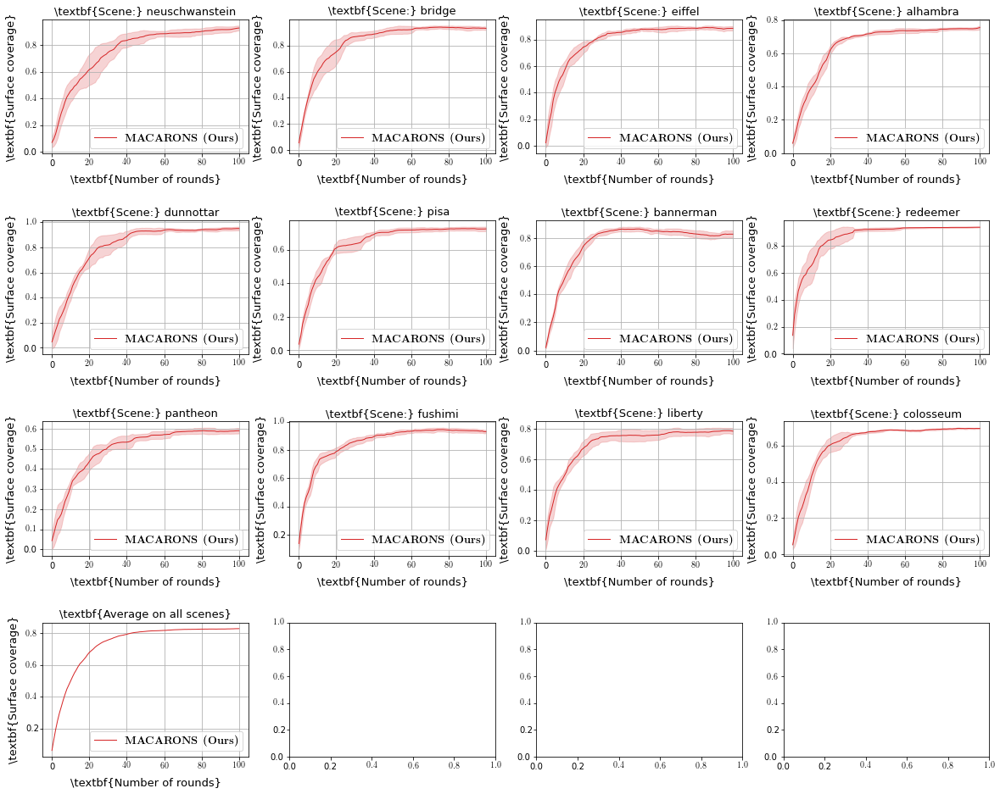

In [8]:
# Plot surface coverage curves
nrows = 4
ncols = len(gp.test_scenes) // nrows + 1

size_factor = 0.25
space = 2
fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(int(ncols*20*size_factor), 
                                                           int((nrows*15 + space*(ncols-1))*size_factor)))

plt.rcParams['text.latex.preamble'] = [r'\boldmath']
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

for i in range(nrows):
    for j in range(ncols):
        if i*ncols + j <= len(gp.test_scenes):
            if i*ncols + j < len(gp.test_scenes):
                scene_name_k = gp.test_scenes[i*ncols + j]
                plot_name_k = r"\textbf{Scene:} " + scene_name_k
            else:
                scene_name_k = 'total'
                plot_name_k = r"\textbf{Average on all scenes}"
            macarons_coverage_k = macarons_coverages[scene_name_k]
            x = np.arange(0, macarons_coverage_k.shape[1], 1)

            fontsize = int(55 * size_factor)
            linewidth = int(5 * size_factor)
            # marker = 'o'
            marker = ""
            markersize = int(10 * size_factor)

            macarons_mean_k = np.mean(macarons_coverage_k, axis=0) 
            macarons_std_k = np.std(macarons_coverage_k, axis=0)

            axs[i,j].plot(x, macarons_mean_k, label=r"\textbf{MACARONS (Ours)}", color='tab:red', 
                          linewidth=linewidth, marker=marker, markersize=markersize)

            if i*ncols + j < len(gp.test_scenes):
                axs[i,j].fill_between(x, macarons_mean_k-macarons_std_k, 
                                      macarons_mean_k+macarons_std_k, 
                                      alpha=0.2, 
                                      edgecolor='tab:red', facecolor='tab:red')

            #axs[i,j].set_xticks([0, 1, 2], fontsize=40)
            #axs[i,j].set_yticks([0, 1, 2], fontsize=40)

            axs[i,j].set_xlabel(r"\textbf{Number of rounds}", fontsize=fontsize, labelpad=int(30*size_factor))
            axs[i,j].set_ylabel(r"\textbf{Surface coverage}", fontsize=fontsize, labelpad=int(30*size_factor))
            axs[i,j].legend(prop={"size":fontsize})
            axs[i,j].grid(True)

            axs[i,j].set_title(plot_name_k, fontsize=fontsize)

plt.subplots_adjust(hspace=space*size_factor)
plt.show()

## Final AUC

We compute the average final AUC on all trajectories for each scene:

In [9]:
def compute_auc(y, dx):
    auc = np.trapz(y, dx=dx) + y[0] * dx / 2.
    return auc


for scene_name_k in macarons_coverages:
    if scene_name_k == 'total':
        to_print = "\n===== All scenes ====="
    else:
        to_print = f"\n----- Scene: {scene_name_k} -----"
    print(to_print)
    
    scene_macarons_coverage_k = macarons_coverages[scene_name_k]
    
    macarons_auc = []
    for i in range(len(scene_macarons_coverage_k)):
        macarons_auc.append(compute_auc(scene_macarons_coverage_k[i], dx=1./gp.params.n_poses_in_trajectory))

    print("MACARONS:", np.mean(macarons_auc), "+/-", np.std(macarons_auc))


----- Scene: neuschwanstein -----
MACARONS: 0.7656511039302805 +/- 0.02974314364509301

----- Scene: bridge -----
MACARONS: 0.833017659359046 +/- 0.021236967629249454

----- Scene: eiffel -----
MACARONS: 0.7943290521189275 +/- 0.01825068033895722

----- Scene: alhambra -----
MACARONS: 0.6559655351799766 +/- 0.010622861873814086

----- Scene: dunnottar -----
MACARONS: 0.8113604712277853 +/- 0.0252116851700606

----- Scene: pisa -----
MACARONS: 0.6398550360747906 +/- 0.01095658106115736

----- Scene: bannerman -----
MACARONS: 0.7626005650663487 +/- 0.017181252421377857

----- Scene: redeemer -----
MACARONS: 0.8677346491447633 +/- 0.01838254389124695

----- Scene: pantheon -----
MACARONS: 0.5033543976948611 +/- 0.014387974424066044

----- Scene: fushimi -----
MACARONS: 0.853767971831435 +/- 0.011969847670941475

----- Scene: liberty -----
MACARONS: 0.7028300136984372 +/- 0.0153727852947465

----- Scene: colosseum -----
MACARONS: 0.6202473325168563 +/- 0.011437595423018336

===== All scen

# Qualitative analysis: Visualize and save final reconstruction

## Select and load a 3D scene

All scenes have a corresponding index:

In [10]:
for i in range(len(gp.test_scenes)):
    print(f"Scene {i}: {gp.test_scenes[i]}")

Scene 0: neuschwanstein
Scene 1: bridge
Scene 2: eiffel
Scene 3: alhambra
Scene 4: dunnottar
Scene 5: pisa
Scene 6: bannerman
Scene 7: redeemer
Scene 8: pantheon
Scene 9: fushimi
Scene 10: liberty
Scene 11: colosseum


Select a scene number:

In [11]:
# Select a scene index
scene_idx = 5

gp.scene_idx = scene_idx
gp.scene_name = gp.test_scenes[scene_idx]
gp.scene_path = os.path.join(gp.scene_folder, gp.scene_name)
gp.res_dict = macarons_res[gp.scene_name]
print(f"'{gp.scene_name}' scene has been selected.")

# Load 3D mesh and scene data
print("\nLoading mesh metadata...")
gp.mesh = None
torch.cuda.empty_cache()
gp.scene_dict = gp.dataloader.dataset[scene_idx]
gp.scene_name = gp.scene_dict['scene_name']
gp.obj_name = gp.scene_dict['obj_name']
gp.settings = gp.scene_dict['settings']
gp.settings = Settings(gp.settings, gp.device, gp.params.scene_scale_factor)
gp.occupied_pose_data = gp.scene_dict['occupied_pose']

gp.mesh_path = os.path.join(gp.scene_path, gp.obj_name)

# Memory info
gp.scene_memory_path = os.path.join(gp.scene_path, gp.params.memory_dir_name)
gp.trajectory_nb = gp.memory.current_epoch % gp.memory.n_trajectories
gp.training_frames_path = gp.memory.get_trajectory_frames_path(gp.scene_memory_path, 
                                                               gp.trajectory_nb)
gp.training_poses_path = gp.memory.get_poses_path(gp.scene_memory_path)

print("Done.")

# Load mesh
print("\nLoading mesh...")
gp.mesh = load_scene(gp.mesh_path, gp.params.scene_scale_factor,
                     gp.device, mirror=False, mirrored_axis=None)
print("Done.")

'pisa' scene has been selected.

Loading mesh metadata...
Done.

Loading mesh...
Done.


## Select a trajectory

Select a trajectory among the following:

In [12]:
# Information about trajectories
print(f"Please select a trajectory index between 0 and {len(gp.res_dict)-1}.")
for traj_i in gp.res_dict:
    traj_dict_i = gp.res_dict[traj_i]
    print(f"\n================== Trajectory {traj_i} ==================")
    print(f"Final surface coverage ------   {traj_dict_i['coverage'][-1]}")
    print(f"AUC -------------------------   {compute_auc(traj_dict_i['coverage'], dx=1./gp.params.n_poses_in_trajectory)}")

Please select a trajectory index between 0 and 4.

================== Trajectory 0 ==================
Final surface coverage ------   0.704199975148076
AUC -------------------------   0.6450189495920141

================== Trajectory 1 ==================
Final surface coverage ------   0.7300716734185104
AUC -------------------------   0.6511692115923965

================== Trajectory 2 ==================
Final surface coverage ------   0.7323305771388209
AUC -------------------------   0.6360572568246977

================== Trajectory 3 ==================
Final surface coverage ------   0.7426922360826662
AUC -------------------------   0.6467575870415192

================== Trajectory 4 ==================
Final surface coverage ------   0.7150995966232794
AUC -------------------------   0.6202721753233252


In [13]:
# Please select a trajectory index
gp.traj_idx = 0

In [14]:
gp.traj_dict = gp.res_dict[str(gp.traj_idx)]

gp.X_cam_history = torch.Tensor((gp.traj_dict['X_cam_history'])).to(gp.device)
gp.V_cam_history = torch.Tensor((gp.traj_dict['V_cam_history'])).to(gp.device)

print(f"Selected trajectory number {gp.traj_idx} for scene '{gp.scene_name}'.")
print(f"The trajectory has {len(gp.X_cam_history)} poses in total.")
print("Coverage:", gp.res_dict[str(gp.traj_idx)]["coverage"][-1])
print("Start X_cam:", gp.X_cam_history[gp.params.n_interpolation_steps])

Selected trajectory number 0 for scene 'pisa'.
The trajectory has 405 poses in total.
Coverage: 0.704199975148076
Start X_cam: tensor([41.8750, 15.0000, 25.0000], device='cuda:0')


In [15]:
# Construct scene objects
print("\nConstructing scene objects...")
gp.gt_scene, gp.covered_scene, gp.surface_scene, gp.proxy_scene = setup_test_scene(gp.params,
                                                                                   gp.mesh,
                                                                                   gp.settings,
                                                                                   mirrored_scene=False,
                                                                                   device=gp.device,
                                                                                   mirrored_axis=None,
                                                                                   surface_scene_feature_dim=3,
                                                                                   test_resolution=gp.test_resolution
                                                                                   )
print("Done.")

# Construct camera
print("\nConstructing camera object...")
gp.start_cam_idx = gp.settings.camera.start_positions[gp.traj_idx]
gp.camera = setup_test_camera(gp.params,
                              gp.mesh,
                              gp.start_cam_idx,
                              gp.settings,
                              gp.occupied_pose_data,
                              gp.device,
                              gp.training_frames_path,
                              mirrored_scene=False,
                              mirrored_axis=None)
print("Done.")

# Initialize trajectory
gp.model.eval()

gp.full_pc = torch.zeros(0, 3, device=gp.device)
gp.full_pc_colors = torch.zeros(0, 3, device=gp.device)


Constructing scene objects...
Done.

Constructing camera object...
Done.


## Visualize trajectory

We display the exploration trajectory in ground truth scene:

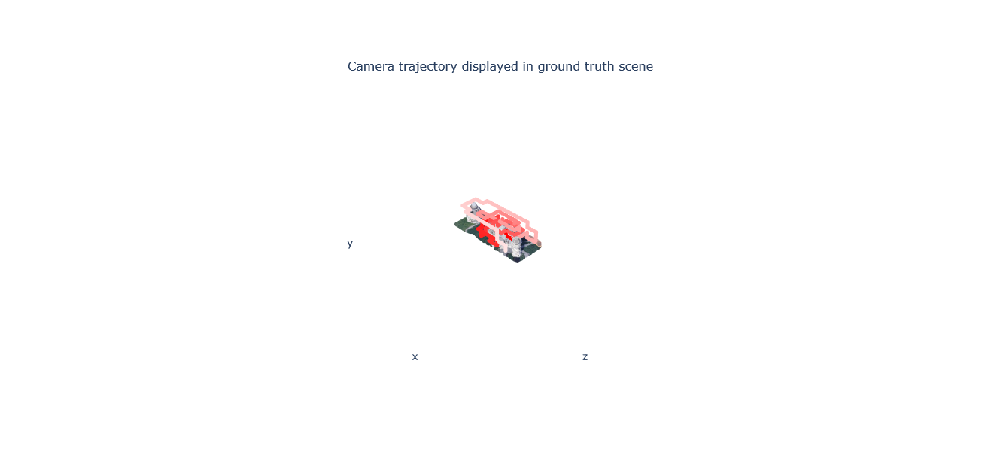

In [17]:
points_to_show = gp.X_cam_history + 0.
# points_to_show = X_cam_history[params.n_interpolation_steps::params.n_interpolation_steps] + 0.

colors_to_show = torch.zeros_like(points_to_show)
colors_to_show[..., 0] += 1
colors_to_show[..., 1] += torch.linspace(0.9, 0.0, len(points_to_show), device=gp.device)
colors_to_show[..., 2] += torch.linspace(0.9, 0.0, len(points_to_show), device=gp.device)

points_to_show_2, colors_to_show_2 = gp.gt_scene.return_entire_pt_cloud(return_features=True)
index_to_show_2 = torch.randperm(len(points_to_show_2))

points_to_show = torch.cat((points_to_show, points_to_show_2[index_to_show_2][:20000-len(points_to_show)]), dim=0)
colors_to_show = torch.cat((colors_to_show, colors_to_show_2[index_to_show_2][:20000-len(colors_to_show)]), dim=0)

plot_point_cloud(points_to_show, colors_to_show, name='Camera trajectory displayed in ground truth scene', 
                 point_size=3, max_points=20000, width=800, height=600, cmap='rgb')

## Recapture RGB images

Start by recapturing the RGB images along the trajectory:

In [18]:
n_frames_to_recapture = 400

for i in range(0, min(n_frames_to_recapture, len(gp.X_cam_history))):
    X_cam = gp.X_cam_history[i:i+1]
    V_cam = gp.V_cam_history[i:i+1]
    
    fov_camera = gp.camera.get_fov_camera_from_XV(X_cam, V_cam)
    
    gp.camera.capture_image(gp.mesh, fov_camera=fov_camera)
    
    if i % 20==0:
        print(i, "frames captured.")

0 frames captured.
20 frames captured.
40 frames captured.
60 frames captured.
80 frames captured.
100 frames captured.
120 frames captured.
140 frames captured.
160 frames captured.
180 frames captured.
200 frames captured.
220 frames captured.
240 frames captured.
260 frames captured.
280 frames captured.
300 frames captured.
320 frames captured.
340 frames captured.
360 frames captured.
380 frames captured.


Display some of  these images:

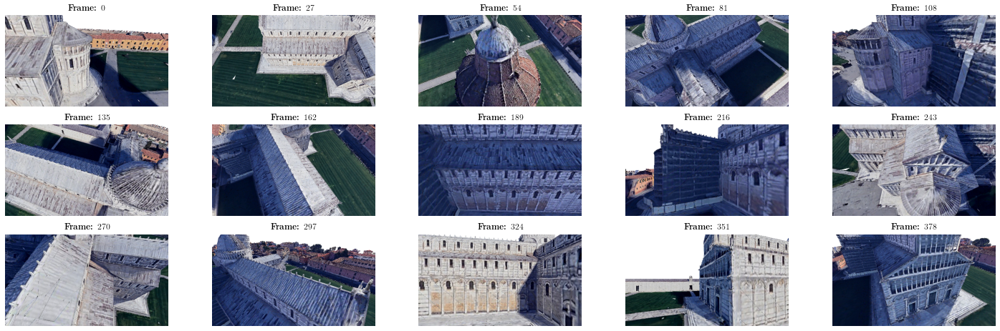

In [19]:
frame_names = os.listdir(gp.camera.save_dir_path)
nrows = 3
ncols = 5

size_factor = 0.011
fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(int(ncols*456*size_factor), int(nrows*256*size_factor)))

n_frames_to_plot = nrows * ncols
n_frames_to_jump = len(frame_names) // n_frames_to_plot

for i in range(nrows):
    for j in range(ncols):
        i_frame = (i * ncols + j) * n_frames_to_jump
        plot_name_k = r"\textbf{Frame:} " + str(i_frame)

        path_k = os.path.join(gp.camera.save_dir_path, str(i_frame) + '.pt')
        frame_k = torch.load(path_k, map_location="cpu")['rgb'][0]

        axs[i,j].imshow(frame_k)
        axs[i,j].axis(False)
        axs[i,j].set_title(plot_name_k)

plt.show()

## Recompute Depth maps

Then, using MACARONS, we recompute the depth maps and surface point cloud corresponding to the RGB images.

In [20]:
gp.params.jitter_probability = 0.
gp.params.symmetry_probability = 0.
gp.depths_memory_path = gp.memory.get_trajectory_depths_path(gp.memory.scene_memory_paths[gp.scene_idx], 0)

gp.full_pc, gp.full_pc_colors = recompute_mapping(gp.params, gp.model,
                                                  gp.camera, gp.proxy_scene, gp.surface_scene,
                                                  gp.device, True,
                                                  save_depths=True,
                                                  save_depth_every_n_frame=1,
                                                  depths_memory_path=gp.depths_memory_path,
                                                  return_colors=True)


Recompute mapping...


/home/aguedon/anaconda3/envs/pytorch3d/lib/python3.8/site-packages/torch/nn/functional.py:3060: UserWarning:

Default upsampling behavior when mode=bicubic is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.

/home/aguedon/anaconda3/envs/pytorch3d/lib/python3.8/site-packages/torch/nn/functional.py:3385: UserWarning:

Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.



Total time for remapping: 56.8689661026001
Size of pc in surface scene: torch.Size([24229, 3])


And we display some of the depth maps:

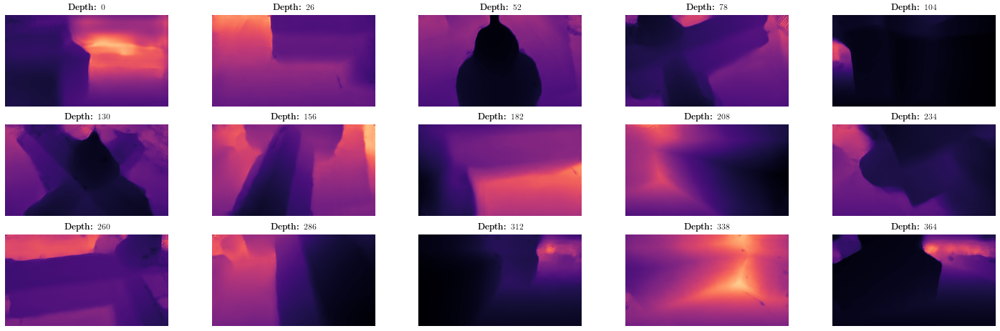

In [21]:
frame_names = os.listdir(gp.depths_memory_path)
nrows = 3
ncols = 5

size_factor = 0.011
fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(int(ncols*456*size_factor), int(nrows*256*size_factor)))

n_frames_to_plot = nrows * ncols
n_frames_to_jump = len(frame_names) // n_frames_to_plot

for i in range(nrows):
    for j in range(ncols):
        i_frame = (i * ncols + j) * n_frames_to_jump
        plot_name_k = r"\textbf{Depth:} " + str(i_frame)

        path_k = os.path.join(gp.depths_memory_path, str(i_frame) + '.pt')
        frame_k = torch.load(path_k, map_location="cpu")['depth'][0, ..., 0]

        axs[i,j].imshow(frame_k, cmap='magma')
        axs[i,j].axis(False)
        axs[i,j].set_title(plot_name_k)

plt.show()

## Compute final reconstructed surface

We plot the full reconstructed surface point cloud, which contains all points backprojected from all depth maps.<br>
Because the predicted depth maps are not perfect and contain errors, this point cloud can be very noisy. 

The full reconstructed surface point cloud contains 2104766 points in total.


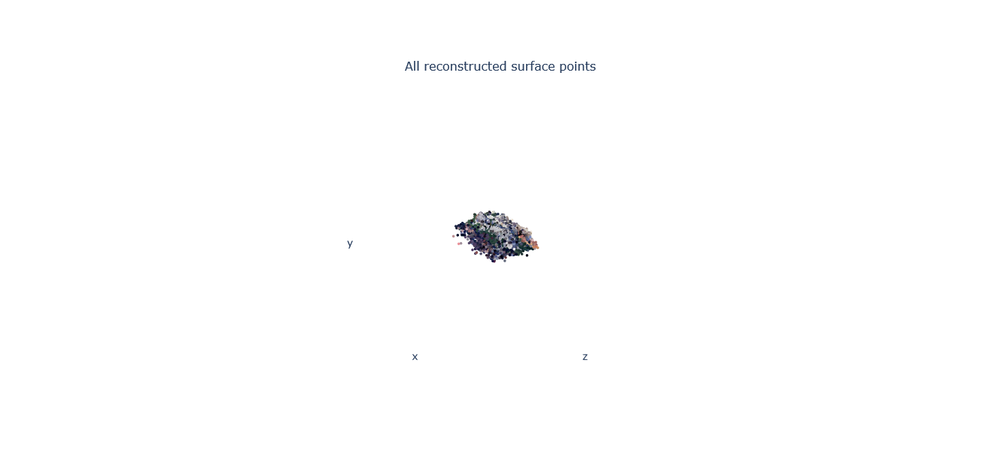

In [22]:
print(f"The full reconstructed surface point cloud contains {gp.full_pc.shape[0]} points in total.")
plot_point_cloud(gp.full_pc, gp.full_pc_colors, name='All reconstructed surface points', 
                 point_size=2, max_points=50000, width=800, height=600, cmap='rgb')

Now, we plot only the surface points we registered during online exploration.<br>
This point cloud is updated in real time and is used for predicting occupancy as well as computing pseudo-ground truth of surface coverage gains.<br>
This point cloud has less points (depending on the hyperparameters) but also less noise, since we remove some of the noisy points with a simple algorithm.

24229 surface points were registered during exploration.


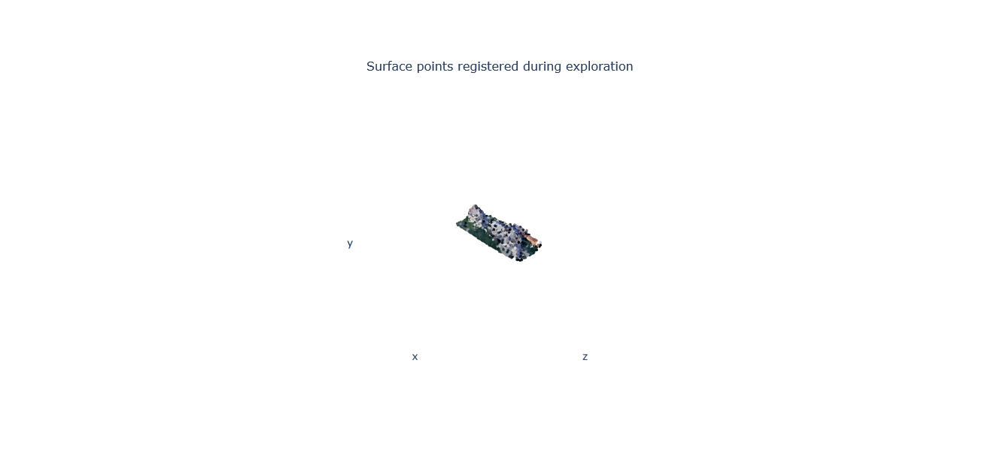

In [23]:
surface_pts, surface_col = gp.surface_scene.return_entire_pt_cloud(return_features=True)
print(f"{surface_pts.shape[0]} surface points were registered during exploration.")
plot_point_cloud(surface_pts, surface_col, name='Surface points registered during exploration', 
                 point_size=2, max_points=len(surface_pts), width=800, height=600, cmap='rgb')

Additionally, once the exploration is over, we can efficiently filter the noisy points from the full reconstructed surface point cloud by performing a carving operation using all of our predicted depth maps. <br>
We apply the same carving operation as the one we use for computing the pseudo-ground truth occupancy field, which is described in the appendix of the paper.<br>
We use the resulting *"filtered"* surface point cloud, which has better quality, to render our qualitative results in the paper.

In [24]:
filtered_n_inside_fov = torch.zeros(len(gp.full_pc), device=gp.device)
filtered_n_behind_depth = torch.zeros(len(gp.full_pc), device=gp.device)

tol = gp.params.carving_tolerance
score_th = gp.params.score_threshold

for i_frame in range(0, len(os.listdir(gp.depths_memory_path))):
    depth_dict = torch.load(os.path.join(gp.depths_memory_path, str(i_frame) + '.pt'), map_location=gp.device)
    
    depth = depth_dict['depth']
    mask = depth_dict['mask']
    R = depth_dict['R']
    T = depth_dict['T']
    fov_camera = gp.camera.get_fov_camera_from_RT(R_cam=R, T_cam=T)
    
    _, fov_mask = gp.camera.get_points_in_fov(pts=gp.full_pc, return_mask=True, 
                                              fov_camera=fov_camera, fov_range=gp.params.sensor_range)
    
    fov_pc = gp.full_pc[fov_mask]
    sgn_dists = gp.camera.get_signed_distance_to_depth_maps(pts=fov_pc, depth_maps=depth, 
                                                            mask=mask.bool(), fov_camera=fov_camera)
    
    filtered_n_inside_fov[fov_mask] += 1
    filtered_n_behind_depth[fov_mask] += sgn_dists.view(-1) >= -tol

The filtered reconstructed surface point cloud contains 1882014 points in total.


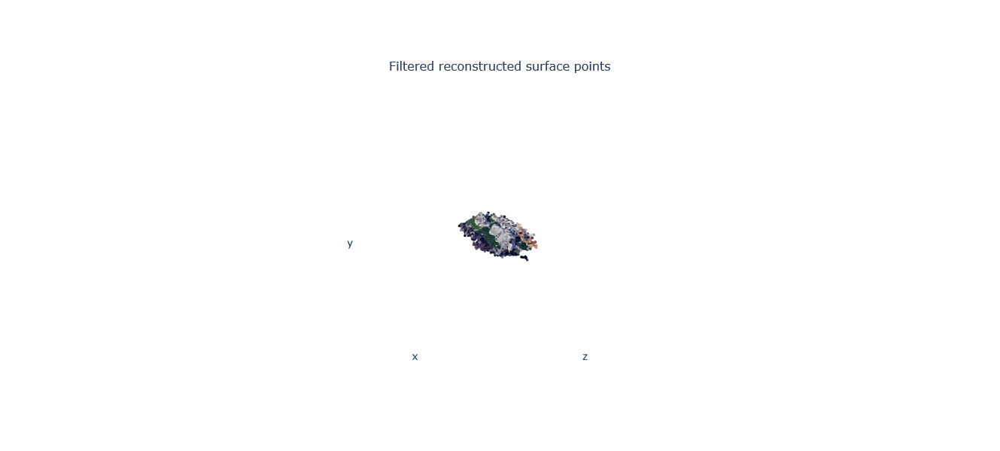

In [25]:
filter_mask = (filtered_n_behind_depth / filtered_n_inside_fov) > score_th

filtered_pc = 0. + gp.full_pc[filter_mask]
filtered_colors = 0. + gp.full_pc_colors[filter_mask]

print(f"The filtered reconstructed surface point cloud contains {filtered_pc.shape[0]} points in total.")
plot_point_cloud(filtered_pc, filtered_colors, name='Filtered reconstructed surface points', 
                 point_size=2, max_points=50000, width=800, height=600, cmap='rgb')

Save final reconstructed surface:

In [27]:
save = True

if save:
    dict_to_save = {'points': filtered_pc.cpu().numpy().tolist(), 'colors': filtered_colors.cpu().numpy().tolist()}
    reconstructed_json_name = os.path.join(results_dir, "reconstructed_" + gp.scene_name + '.json')
    
    print(f"Scene name: {gp.scene_name}")
    print(f"Number of surface points to save: {len(dict_to_save['points'])}.")
    print(f"Path to the json file to save: {reconstructed_json_name}")

    with open(reconstructed_json_name, 'w') as outfile:
        json.dump(dict_to_save, outfile)

Scene name: pisa
Number of surface points to save: 1882014.
Path to the json file to save: /home/aguedon/pycharm_projects/pycharm_project1/MACARONS/MACARONS/macarons/testers/../../results/scene_exploration/reconstructed_pisa.json


## Compute final occupancy field

We compute the final volume occupancy value of the proxy points:

In [28]:
with torch.no_grad():
    occupancy_X, view_harmonics, occupancy_sigma = compute_scene_occupancy_probability_field(gp.params,
                                                                                             gp.model.scone,
                                                                                             gp.camera,
                                                                                             gp.surface_scene,
                                                                                             gp.proxy_scene,
                                                                                             gp.device)

We plot the predicted occupancy field (we remove the points with a probability < 0.5 for better visualization):

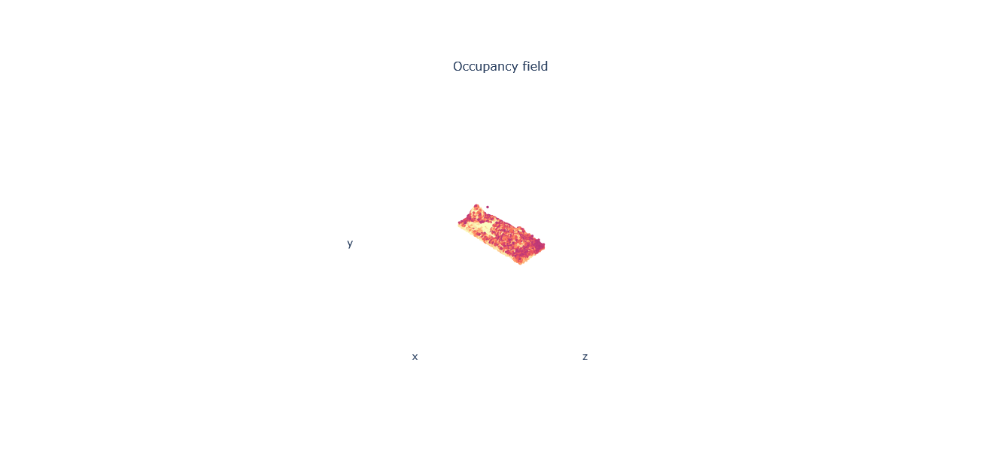

In [29]:
occ_mask = occupancy_sigma[..., 0] > 0.5
X = occupancy_X[occ_mask]
c = occupancy_sigma[..., 0][occ_mask]

plot_point_cloud(X, c, name='Occupancy field', 
                 point_size=2, max_points=20000, width=800, height=600, cmap='magma')

Then, we plot the final pseudo-ground truth occupancy field, obtained by performing carving operations using all depth maps:

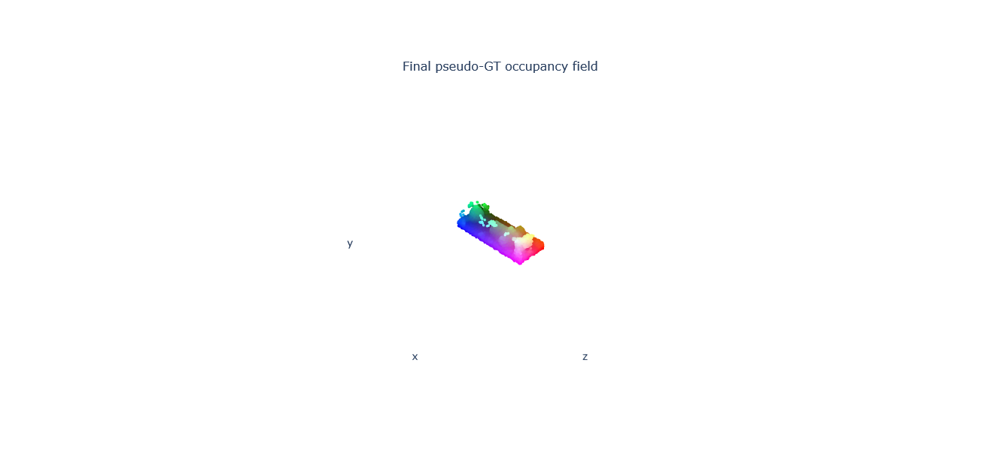

In [30]:
supervision_occ_mask = (gp.proxy_scene.proxy_supervision_occ[..., 0] > 0.5) * (gp.proxy_scene.out_of_field[..., 0] < 1)
s_X = gp.proxy_scene.proxy_points[supervision_occ_mask]
s_c = (s_X - s_X.min(dim=0)[0]) / (s_X.max(dim=0)[0] - s_X.min(dim=0)[0])

plot_point_cloud(s_X, s_c, name='Final pseudo-GT occupancy field', 
                 point_size=2, max_points=20000, width=800, height=600, cmap='rgb')

Save final occupancy field:

In [32]:
save = True

if save:
    dict_to_save = {'points': s_X.cpu().numpy().tolist()}
    occupancy_json_name = os.path.join(results_dir, "occupancy_" + gp.scene_name + '.json')
    
    print(f"Scene name: {gp.scene_name}")
    print(f"Number of surface points to save: {len(dict_to_save['points'])}.")
    print(f"Path to the json file to save: {occupancy_json_name}")

    with open(occupancy_json_name, 'w') as outfile:
        json.dump(dict_to_save, outfile)

Scene name: pisa
Number of surface points to save: 35030.
Path to the json file to save: /home/aguedon/pycharm_projects/pycharm_project1/MACARONS/MACARONS/macarons/testers/../../results/scene_exploration/occupancy_pisa.json
